<a href="https://colab.research.google.com/github/ezzaddeentru/notebooks/blob/main/Copy_of_predict_Listening_Time_minutes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()


Kaggle credentials set.
Kaggle credentials successfully validated.


In [4]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

playground_series_s5e4_path = kagglehub.competition_download('playground-series-s5e4')

print('Data source import complete.')


100%|██████████| 22.3M/22.3M [00:00<00:00, 166MB/s]

Extracting files...


Data source import complete.


In [6]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk(playground_series_s5e4_path):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/root/.cache/kagglehub/competitions/playground-series-s5e4/sample_submission.csv
/root/.cache/kagglehub/competitions/playground-series-s5e4/test.csv
/root/.cache/kagglehub/competitions/playground-series-s5e4/train.csv


In [7]:
!wget https://raw.githubusercontent.com/ezzaddeentru/used-cars-selling-price-estimating---case-study/refs/heads/main/reg_helper_functions.py

--2025-05-22 13:33:01--  https://raw.githubusercontent.com/ezzaddeentru/used-cars-selling-price-estimating---case-study/refs/heads/main/reg_helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 19287 (19K) [text/plain]
Saving to: ‘reg_helper_functions.py’

reg_helper_function 100%[===================>]  18.83K  --.-KB/s    in 0s      

2025-05-22 13:33:01 (124 MB/s) - ‘reg_helper_functions.py’ saved [19287/19287]



In [8]:
from reg_helper_functions import *

In [9]:
!wget https://raw.githubusercontent.com/ezzaddeentru/recipe-popularity-prediction/main/helper_functions.py


--2025-05-22 13:33:05--  https://raw.githubusercontent.com/ezzaddeentru/recipe-popularity-prediction/main/helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 43593 (43K) [text/plain]
Saving to: ‘helper_functions.py’

helper_functions.py 100%[===================>]  42.57K  --.-KB/s    in 0.001s  

2025-05-22 13:33:05 (33.2 MB/s) - ‘helper_functions.py’ saved [43593/43593]



In [10]:
from helper_functions import *

In [29]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [118]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

# Data

In [50]:
train_df = pd.read_csv('/root/.cache/kagglehub/competitions/playground-series-s5e4/train.csv')
train_df.head()

,id,Podcast_Name,Episode_Title,Episode_Length_minutes,Genre,Host_Popularity_percentage,Publication_Day,Publication_Time,Guest_Popularity_percentage,Number_of_Ads,Episode_Sentiment,Listening_Time_minutes
0,0,Mystery Matters,Episode 98,NaN,True Crime,74.81,Thursday,Night,NaN,0.0,Positive,31.41998
1,1,Joke Junction,Episode 26,119.80,Comedy,66.95,Saturday,Afternoon,75.95,2.0,Negative,88.01241
2,2,Study Sessions,Episode 16,73.90,Education,69.97,Tuesday,Evening,8.97,0.0,Negative,44.92531
3,3,Digital Digest,Episode 45,67.17,Technology,57.22,Monday,Morning,78.70,2.0,Positive,46.27824
4,4,Mind & Body,Episode 86,110.51,Health,80.07,Monday,Afternoon,58.68,3.0,Neutral,75.61031


In [46]:
train_df.shape

(750000, 12)

In [13]:
test_df = pd.read_csv('/root/.cache/kagglehub/competitions/playground-series-s5e4/test.csv')
sub_df = pd.read_csv('/root/.cache/kagglehub/competitions/playground-series-s5e4/sample_submission.csv')
test_df.head()

,id,Podcast_Name,Episode_Title,Episode_Length_minutes,Genre,Host_Popularity_percentage,Publication_Day,Publication_Time,Guest_Popularity_percentage,Number_of_Ads,Episode_Sentiment
0,750000,Educational Nuggets,Episode 73,78.96,Education,38.11,Saturday,Evening,53.33,1.0,Neutral
1,750001,Sound Waves,Episode 23,27.87,Music,71.29,Sunday,Morning,NaN,0.0,Neutral
2,750002,Joke Junction,Episode 11,69.10,Comedy,67.89,Friday,Evening,97.51,0.0,Positive
3,750003,Comedy Corner,Episode 73,115.39,Comedy,23.40,Sunday,Morning,51.75,2.0,Positive
4,750004,Life Lessons,Episode 50,72.32,Lifestyle,58.10,Wednesday,Morning,11.30,2.0,Neutral


In [14]:
test_df.shape

(250000, 11)

In [15]:
sub_df.head()

,id,Listening_Time_minutes
0,750000,45.437
1,750001,45.437
2,750002,45.437
3,750003,45.437
4,750004,45.437


In [16]:
sub_df.shape

(250000, 2)

In [87]:
test_df.describe()

,id,Episode_Length_minutes,Host_Popularity_percentage,Guest_Popularity_percentage,Number_of_Ads
count,250000.000000,2.212640e+05,250000.000000,201168.000000,250000.000000
mean,874999.500000,4.192987e+02,59.716491,52.192796,1.355852
std,72168.927986,1.668545e+05,22.880028,28.445034,4.274399
min,750000.000000,2.470000e+00,2.490000,0.000000,0.000000
25%,812499.750000,3.578000e+01,39.250000,28.320000,0.000000
50%,874999.500000,6.397000e+01,59.900000,53.360000,1.000000
75%,937499.250000,9.415000e+01,79.390000,76.560000,2.000000
max,999999.000000,7.848626e+07,117.760000,116.820000,2063.000000


# Plan
1. Load and explore the data:
2. Baseline model:
    - Use a LightGBM or XGBoost regressor with basic preprocessing.
    - Evaluate with cross-validation (likely RMSE or MAE).

# EDA

In [17]:
train_df.head(2)

,id,Podcast_Name,Episode_Title,Episode_Length_minutes,Genre,Host_Popularity_percentage,Publication_Day,Publication_Time,Guest_Popularity_percentage,Number_of_Ads,Episode_Sentiment,Listening_Time_minutes
0,0,Mystery Matters,Episode 98,NaN,True Crime,74.81,Thursday,Night,NaN,0.0,Positive,31.41998
1,1,Joke Junction,Episode 26,119.8,Comedy,66.95,Saturday,Afternoon,75.95,2.0,Negative,88.01241


In [18]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 750000 entries, 0 to 749999
Data columns (total 12 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           750000 non-null  int64  
 1   Podcast_Name                 750000 non-null  object 
 2   Episode_Title                750000 non-null  object 
 3   Episode_Length_minutes       662907 non-null  float64
 4   Genre                        750000 non-null  object 
 5   Host_Popularity_percentage   750000 non-null  float64
 6   Publication_Day              750000 non-null  object 
 7   Publication_Time             750000 non-null  object 
 8   Guest_Popularity_percentage  603970 non-null  float64
 9   Number_of_Ads                749999 non-null  float64
 10  Episode_Sentiment            750000 non-null  object 
 11  Listening_Time_minutes       750000 non-null  float64
dtypes: float64(5), int64(1), object(6)
memory usage: 68.7+ MB


In [19]:
train_df.describe()

,id,Episode_Length_minutes,Host_Popularity_percentage,Guest_Popularity_percentage,Number_of_Ads,Listening_Time_minutes
count,750000.000000,662907.000000,750000.000000,603970.000000,749999.000000,750000.000000
mean,374999.500000,64.504738,59.859901,52.236449,1.348855,45.437406
std,216506.495284,32.969603,22.873098,28.451241,1.151130,27.138306
min,0.000000,0.000000,1.300000,0.000000,0.000000,0.000000
25%,187499.750000,35.730000,39.410000,28.380000,0.000000,23.178350
50%,374999.500000,63.840000,60.050000,53.580000,1.000000,43.379460
75%,562499.250000,94.070000,79.530000,76.600000,2.000000,64.811580
max,749999.000000,325.240000,119.460000,119.910000,103.910000,119.970000


In [20]:
train_df.describe(include='object')

,Podcast_Name,Episode_Title,Genre,Publication_Day,Publication_Time,Episode_Sentiment
count,750000,750000,750000,750000,750000,750000
unique,48,100,10,7,4,3
top,Tech Talks,Episode 71,Sports,Sunday,Night,Neutral
freq,22847,10515,87606,115946,196849,251291


In [51]:
train_df.isna().sum()

,0
id,0
Podcast_Name,0
Episode_Title,0
Episode_Length_minutes,87093
Genre,0
Host_Popularity_percentage,0
Publication_Day,0
Publication_Time,0
Guest_Popularity_percentage,146030
Number_of_Ads,1


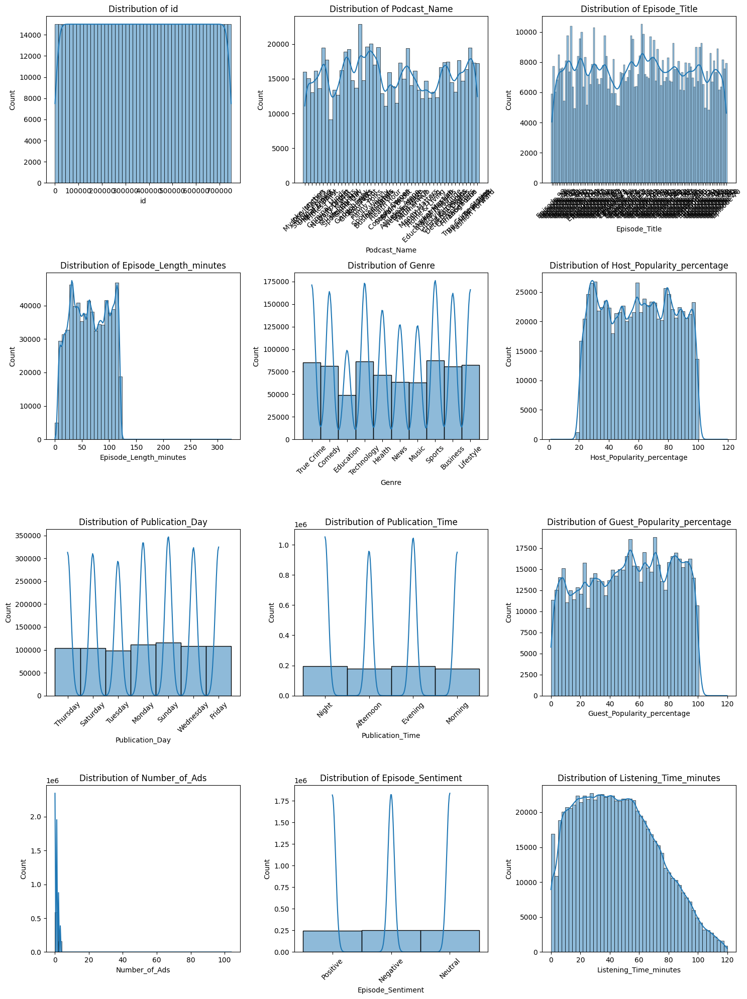

In [21]:
plot_feature_distributions(train_df)

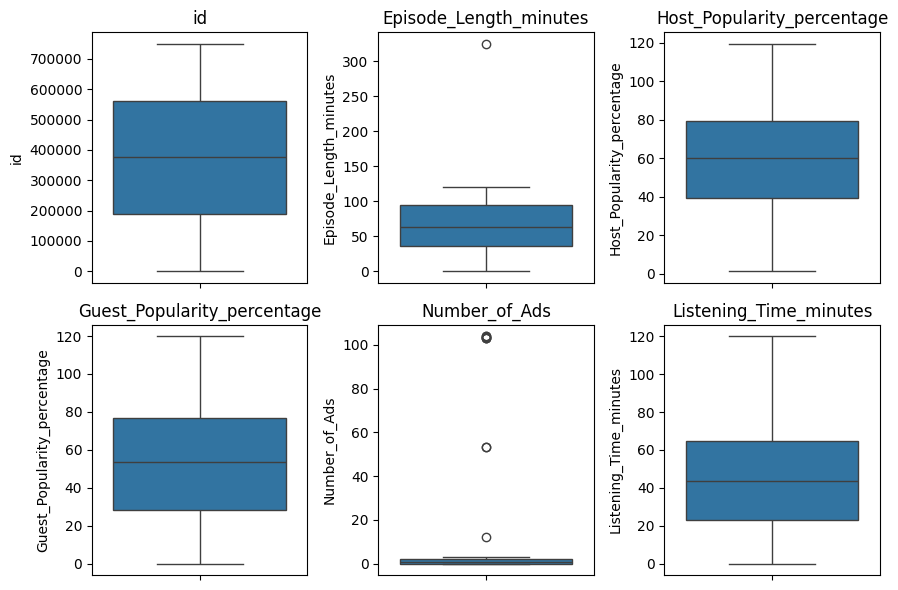

In [24]:
plot_numerical_features(train_df)

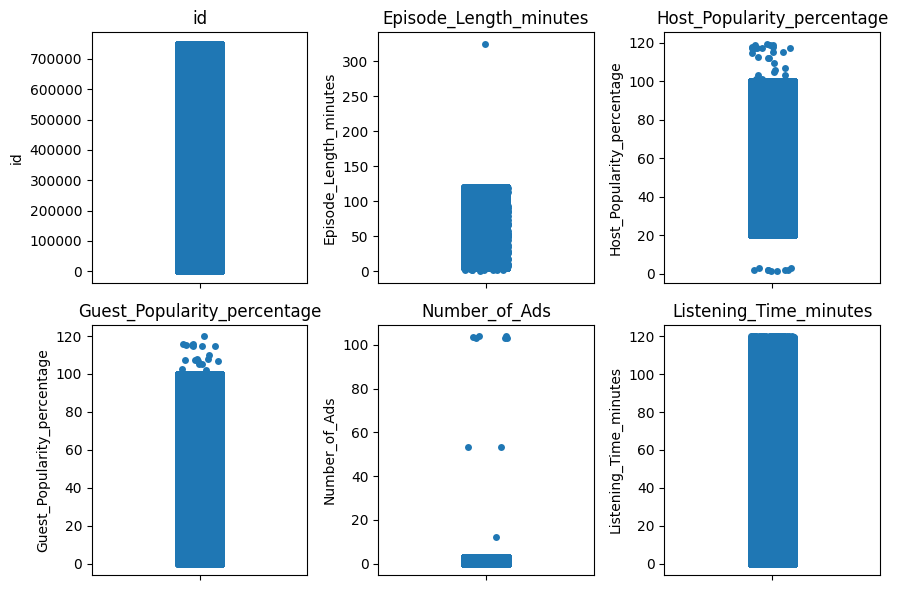

In [25]:
plot_numerical_features(train_df, 'stripplot')

We can see outliers on some features exist.

In [ ]:
!pip install ydata-profiling

In [27]:
from ydata_profiling import ProfileReport

profile = ProfileReport(train_df, title="Pandas Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 12/12 [00:10<00:00,  1.14it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]


Correlation Matrix:


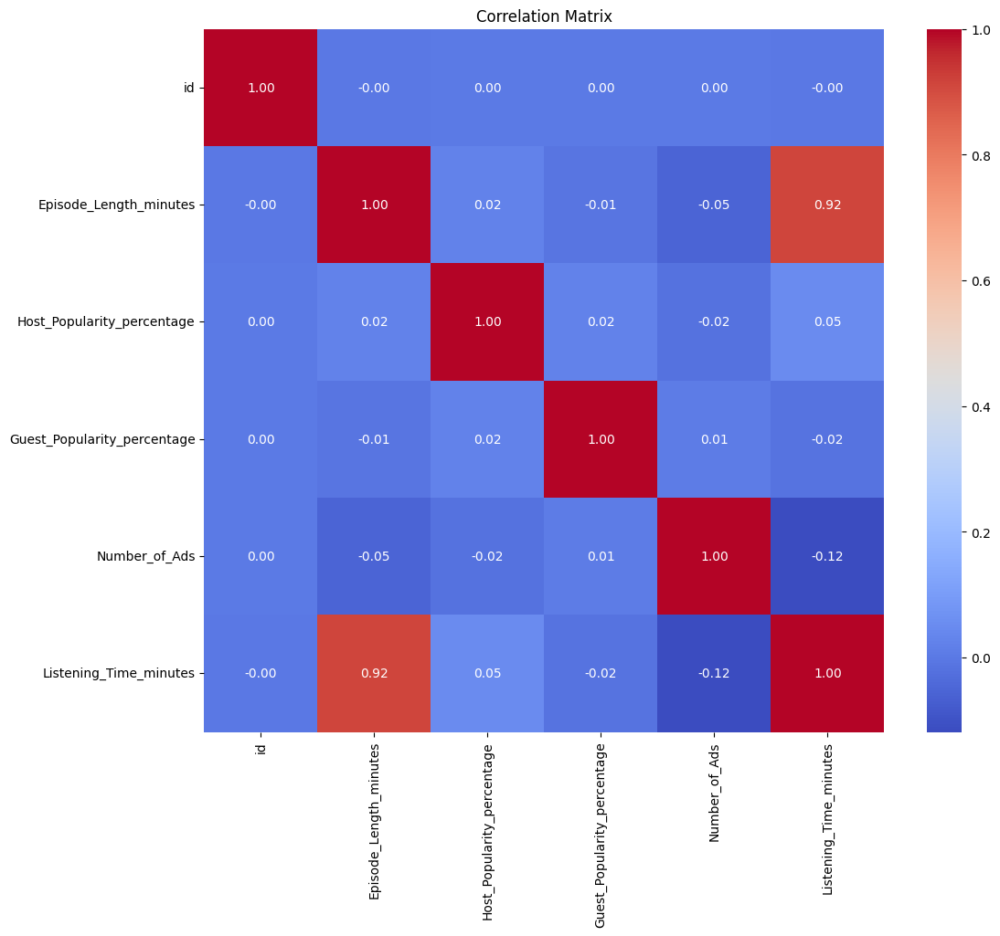

In [28]:
print("\nCorrelation Matrix:")
correlation_matrix = train_df.select_dtypes(include=np.number).corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

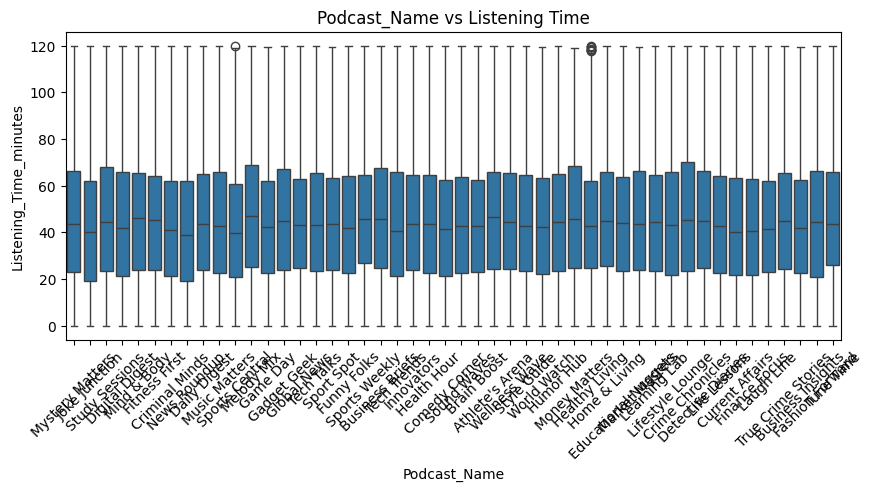

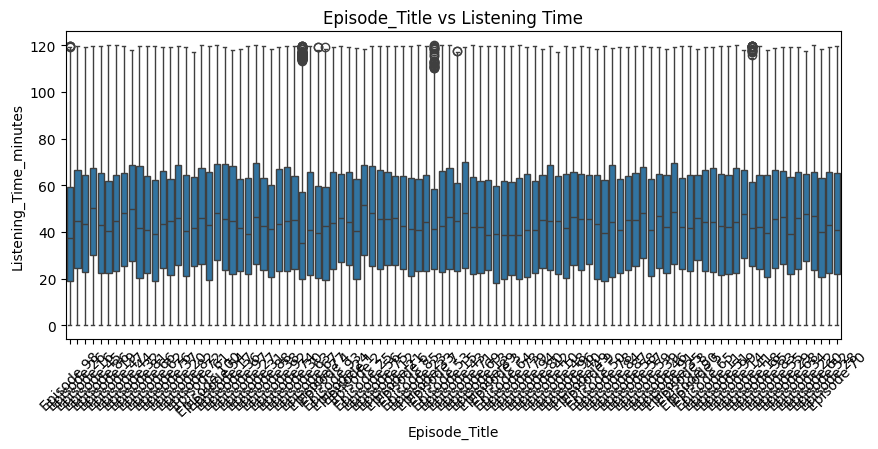

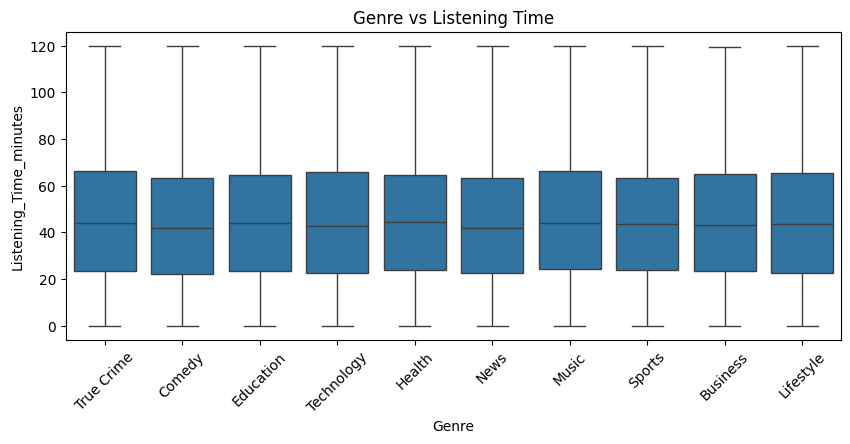

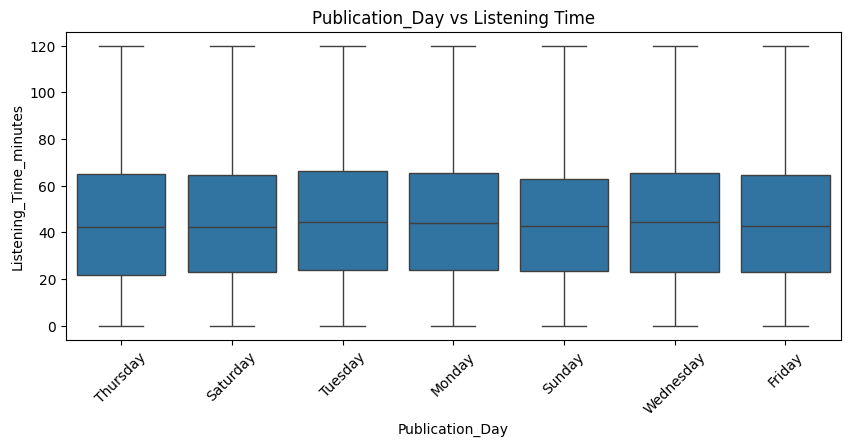

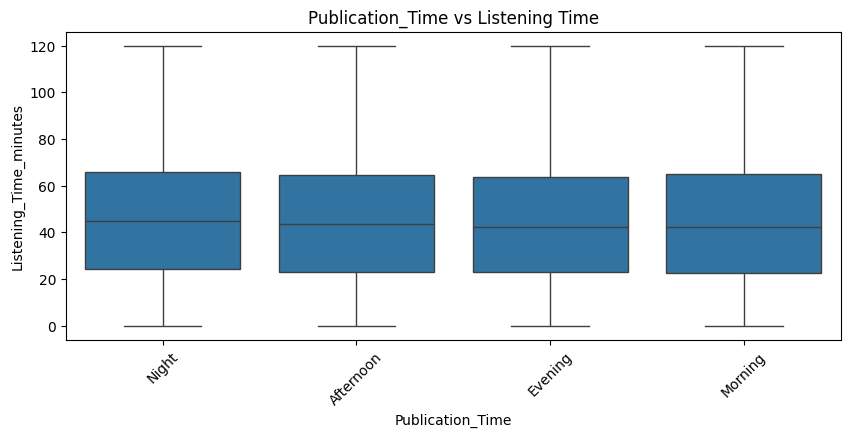

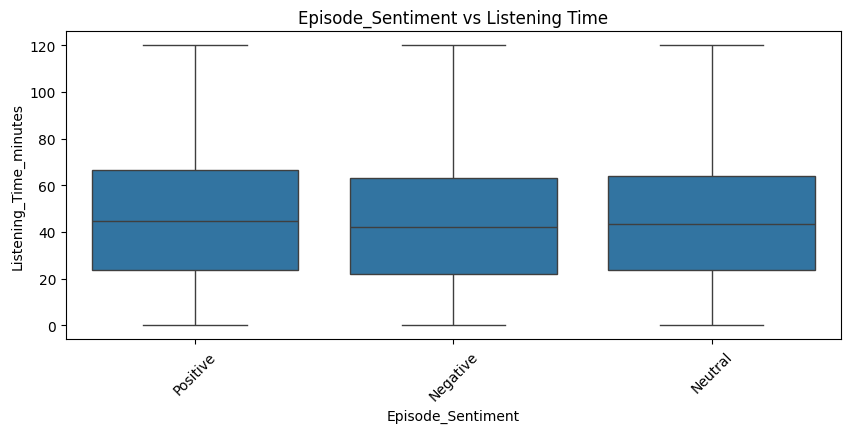

In [30]:
categorical_cols = train_df.select_dtypes(include='object').columns

for col in categorical_cols:
    plt.figure(figsize=(10, 4))
    sns.boxplot(data=train_df, x=col, y='Listening_Time_minutes')
    plt.title(f'{col} vs Listening Time')
    plt.xticks(rotation=45)
    plt.show()


strange, no clear patterns here.

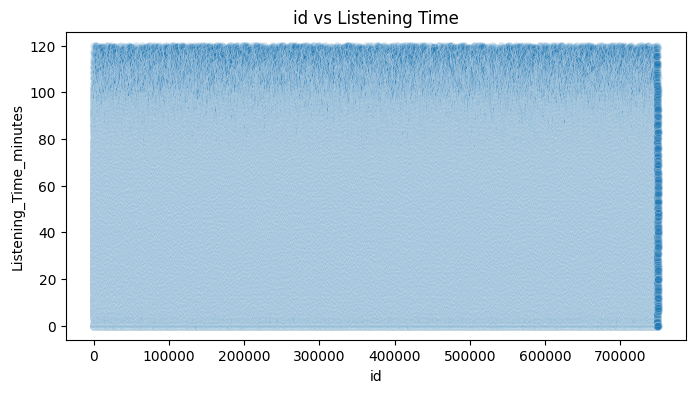

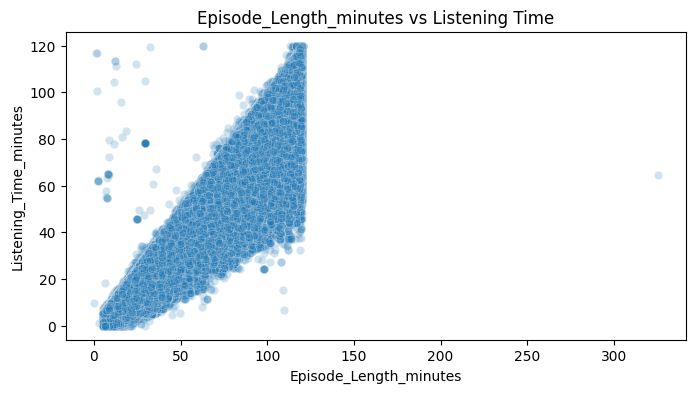

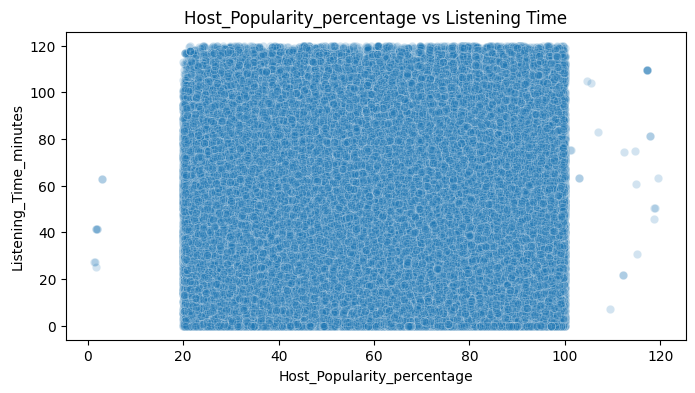

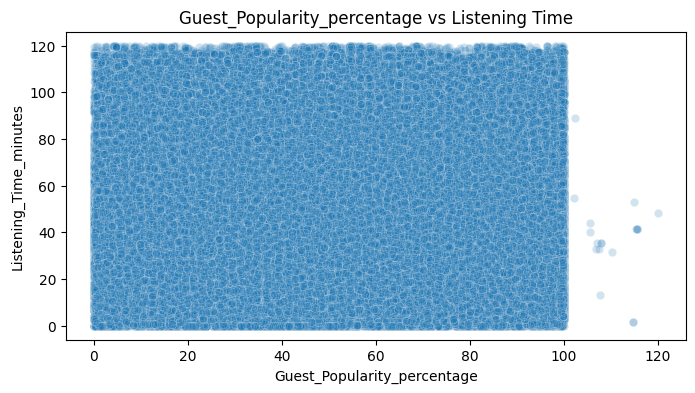

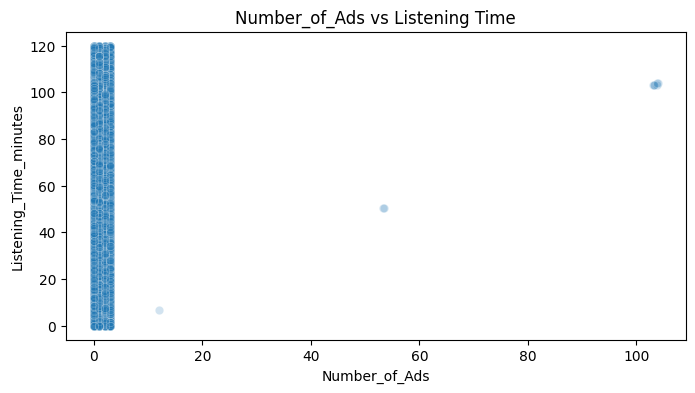

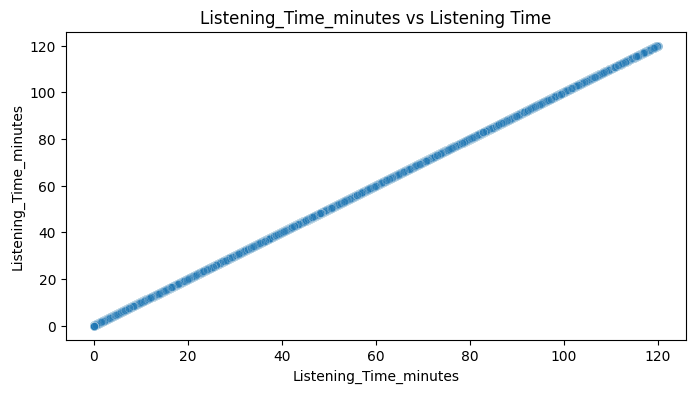

In [33]:
numerical_cols = train_df.select_dtypes(include=np.number).columns

for col in numerical_cols:
    plt.figure(figsize=(8, 4))
    sns.scatterplot(data=train_df, x=col, y='Listening_Time_minutes', alpha=0.2)
    plt.title(f'{col} vs Listening Time')
    plt.show()

# Modeling

## Cleaning

In [48]:
df = train_df.copy()
df = df.drop('id', axis=1)

# Drop rows with any NaN values
df = df.dropna()

# Define a function to remove outliers using IQR
def remove_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Remove outliers from all numerical columns except the target
numerical_cols = df.select_dtypes(include=np.number).columns.tolist()
if 'Listening_Time_minutes' in numerical_cols:
    numerical_cols.remove('Listening_Time_minutes') # Assuming this is your target variable

for col in numerical_cols:
    train_df = remove_outliers_iqr(df, col)

print("DataFrame after cleaning:")
print(f"New shape: {df.shape}")

DataFrame after cleaning:
New shape: (539048, 11)


In [47]:
train_df.shape

(750000, 12)

In [49]:
train_df.isna().sum()

,0
Podcast_Name,0
Episode_Title,0
Episode_Length_minutes,0
Genre,0
Host_Popularity_percentage,0
Publication_Day,0
Publication_Time,0
Guest_Popularity_percentage,0
Number_of_Ads,0
Episode_Sentiment,0


In [55]:
df = df[df['Number_of_Ads'] <= 20]
df = df[df['Host_Popularity_percentage'] <= 100]
df = df[df['Guest_Popularity_percentage'] <= 100]
df = df[df['Episode_Length_minutes'] <= 200]

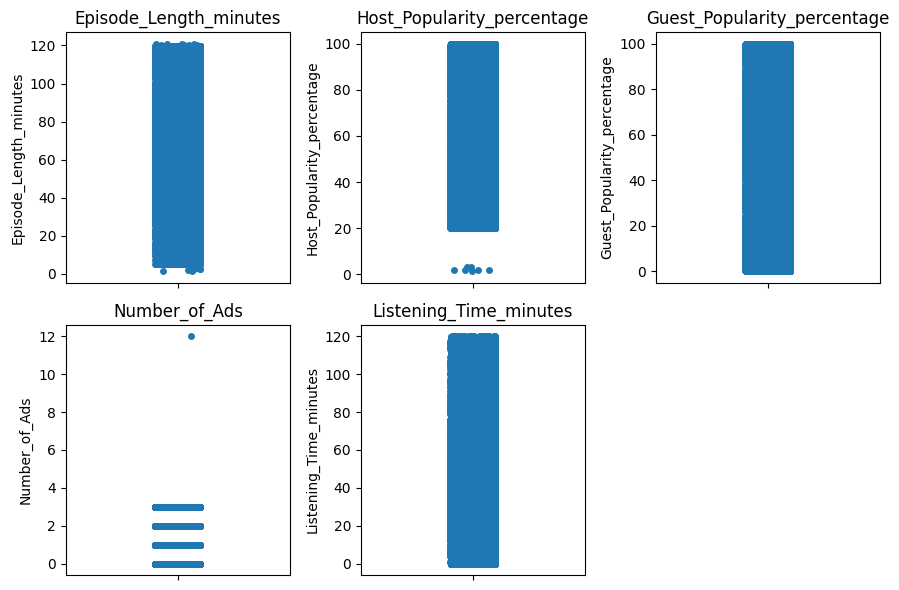

In [56]:
plot_numerical_features(df, 'stripplot')

In [57]:
df.shape

(539003, 11)

In [59]:
initial_cols = train_df.shape[1]
current_cols = df.shape[1]
deleted_cols = initial_cols - current_cols
percent_deleted_cols = (deleted_cols / initial_cols) * 100
print(f"Percentage of rows deleted: {percent_deleted_cols:.2f}%")


Percentage of rows deleted: 8.33%


## LightGBM

In [60]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb
from sklearn.metrics import mean_squared_error

In [61]:
categorical_cols

Index(['Podcast_Name', 'Episode_Title', 'Genre', 'Publication_Day',
       'Publication_Time', 'Episode_Sentiment'],
      dtype='object')

In [63]:
# Label encode categorical features
for col in categorical_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])

In [66]:
df.head(4)

,Podcast_Name,Episode_Title,Episode_Length_minutes,Genre,Host_Popularity_percentage,Publication_Day,Publication_Time,Guest_Popularity_percentage,Number_of_Ads,Episode_Sentiment,Listening_Time_minutes
1,24,19,119.80,1,66.95,2,0,75.95,2.0,0,88.01241
2,40,8,73.90,2,69.97,5,1,8.97,0.0,0,44.92531
3,10,40,67.17,8,57.22,1,2,78.70,2.0,2,46.27824
4,31,85,110.51,3,80.07,1,0,58.68,3.0,1,75.61031


In [71]:
X = df.drop('Listening_Time_minutes', axis=1)
y = df['Listening_Time_minutes']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((431202, 10), (107801, 10), (431202,), (107801,))

In [72]:
train_set = lgb.Dataset(X_train, label=y_train)
val_set = lgb.Dataset(X_val, label=y_val)

In [70]:
train_set

In [77]:
params = {
    'objective': 'regression',
    'metric': 'rmse',
    'verbosity': -1,
    'boosting_type': 'gbdt'
}

lgb = lgb.train(params,
                train_set,
                valid_sets=[train_set, val_set],
                num_boost_round=1000)


In [99]:
lgb

In [81]:
y_train_pred_lgb = lgb.predict(X_train)
y_val_pred_lgb = lgb.predict(X_val)

In [82]:
lgb_metrics = regression_metrics_df(y_train, y_train_pred_lgb, y_val, y_val_pred_lgb, 'lgb')
lgb_metrics

,Metric,Train Set,Test Set,Model
0,RMSE,9.71,10.33,lgb
1,MAPE (%),inf,inf,lgb
2,R2 Score,0.87,0.86,lgb
3,MAE,7.55,7.95,lgb
4,Relative Error to Mean (%),21.20,22.60,lgb


In [84]:
plot_residuals(y_train, y_train_pred_lgb, 'LightGBM Training Residuals')

In [86]:
plot_residuals(y_val, y_val_pred_lgb, 'LightGBM Validation Residuals')

## Other

# Test data

In [88]:
test_df.head()

,id,Podcast_Name,Episode_Title,Episode_Length_minutes,Genre,Host_Popularity_percentage,Publication_Day,Publication_Time,Guest_Popularity_percentage,Number_of_Ads,Episode_Sentiment
0,750000,Educational Nuggets,Episode 73,78.96,Education,38.11,Saturday,Evening,53.33,1.0,Neutral
1,750001,Sound Waves,Episode 23,27.87,Music,71.29,Sunday,Morning,NaN,0.0,Neutral
2,750002,Joke Junction,Episode 11,69.10,Comedy,67.89,Friday,Evening,97.51,0.0,Positive
3,750003,Comedy Corner,Episode 73,115.39,Comedy,23.40,Sunday,Morning,51.75,2.0,Positive
4,750004,Life Lessons,Episode 50,72.32,Lifestyle,58.10,Wednesday,Morning,11.30,2.0,Neutral


In [91]:
X_test = test_df.drop('id', axis=1)

text_categorical_cols = X_test.select_dtypes(include='object').columns

for col in text_categorical_cols:
    le = LabelEncoder()
    X_test[col] = le.fit_transform(X_test[col])

X_test.shape

(250000, 10)

In [94]:
X_test.head()

,Podcast_Name,Episode_Title,Episode_Length_minutes,Genre,Host_Popularity_percentage,Publication_Day,Publication_Time,Guest_Popularity_percentage,Number_of_Ads,Episode_Sentiment
0,11,71,78.96,2,38.11,2,1,53.33,1.0,1
1,36,16,27.87,5,71.29,3,2,NaN,0.0,1
2,24,3,69.10,1,67.89,0,1,97.51,0.0,2
3,4,71,115.39,1,23.40,3,2,51.75,2.0,2
4,27,46,72.32,4,58.10,6,2,11.30,2.0,1


In [95]:
y_test_pred_lgb = lgb.predict(X_test)
y_test_pred_lgb

array([54.79211902, 18.84925744, 49.9874617 , ...,  6.6145182 ,
       74.25969737, 58.15636473])

In [96]:
sub_df['Listening_Time_minutes'] = y_test_pred_lgb
sub_df.head()

,id,Listening_Time_minutes
0,750000,54.792119
1,750001,18.849257
2,750002,49.987462
3,750003,79.331988
4,750004,48.237829


In [97]:
sub_df.to_csv('submission.csv', index=False)

- The score I got of this basic solution is 19 rmse on the test set on Kaggle compared to the best sub 11 rmse.

# Other solutions

## LR

Equation of the line: y = 0.7580x + -3.1222


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



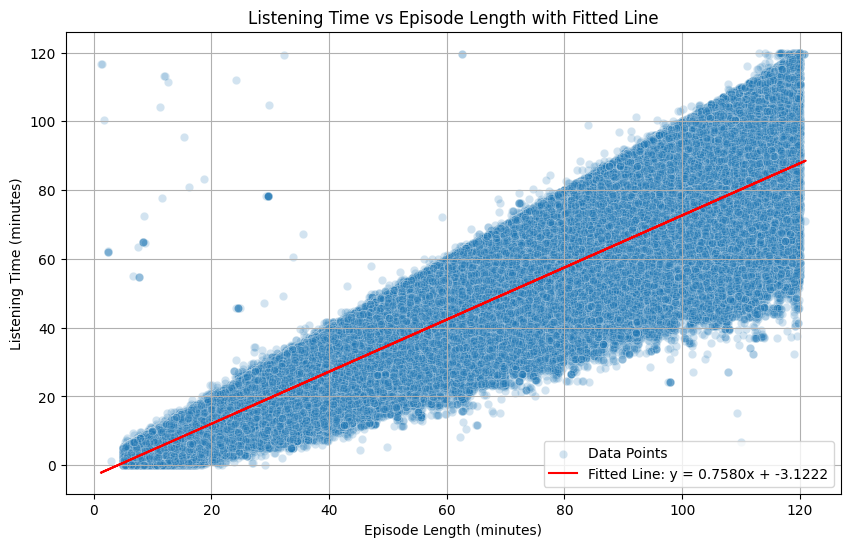

In [106]:
# Fit a line using numpy.polyfit
x = df['Episode_Length_minutes']
y = df['Listening_Time_minutes']

# Use polyfit to find the coefficients of a 1st-degree polynomial (a line)
# coefficients will be [slope, intercept]
coefficients = np.polyfit(x, y, 1)
slope = coefficients[0]
intercept = coefficients[1]

# Print the equation of the line
print(f"Equation of the line: y = {slope:.4f}x + {intercept:.4f}")

# Create the line using the fitted coefficients
y_fit = slope * x + intercept

# Plot the scatter plot and the fitted line
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='Episode_Length_minutes', y='Listening_Time_minutes', alpha=0.2, label='Data Points')
plt.plot(x, y_fit, color='red', label=f'Fitted Line: y = {slope:.4f}x + {intercept:.4f}')
plt.title('Listening Time vs Episode Length with Fitted Line')
plt.xlabel('Episode Length (minutes)')
plt.ylabel('Listening Time (minutes)')
plt.legend()
plt.grid(True)
plt.show()

In [116]:
b = np.linalg.lstsq(df[["Episode_Length_minutes"]], df.Listening_Time_minutes, rcond=None)[0]
b

array([0.71958558])

Linear Regression Model Performance:
Training RMSE: 10.9531
Validation RMSE: 10.9619
Training R-squared: 0.8385
Validation R-squared: 0.8369
Intercept: -3.1371
Coefficient for Episode_Length_minutes: 0.7582


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



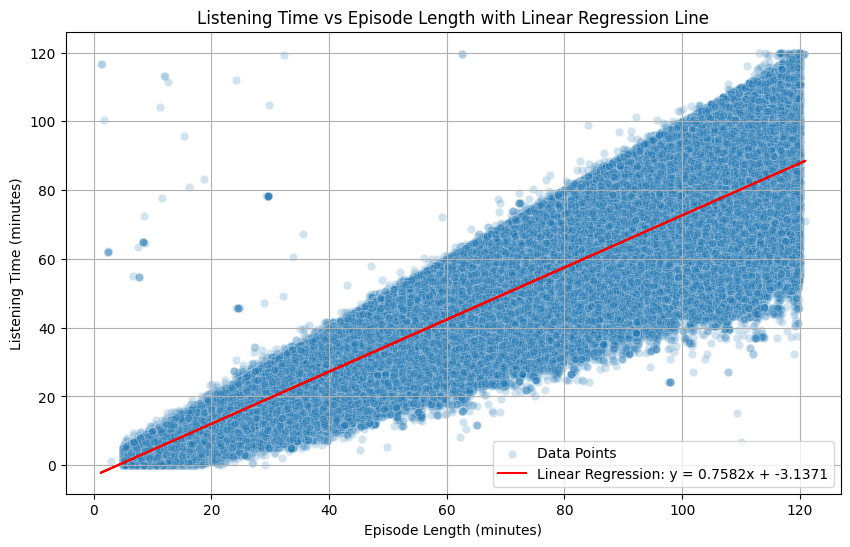

In [120]:
# Select the features and target
X = df[['Episode_Length_minutes']]
y = df['Listening_Time_minutes']

# Split the data into training and validation sets
X_train_lr, X_val_lr, y_train_lr, y_val_lr = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the Linear Regression model
lr_model = LinearRegression()
lr_model.fit(X_train_lr, y_train_lr)

# Make predictions
y_train_pred_lr = lr_model.predict(X_train_lr)
y_val_pred_lr = lr_model.predict(X_val_lr)

# Evaluate the model
rmse_train_lr = np.sqrt(mean_squared_error(y_train_lr, y_train_pred_lr))
rmse_val_lr = np.sqrt(mean_squared_error(y_val_lr, y_val_pred_lr))
r2_train_lr = r2_score(y_train_lr, y_train_pred_lr)
r2_val_lr = r2_score(y_val_lr, y_val_pred_lr)

print("Linear Regression Model Performance:")
print(f"Training RMSE: {rmse_train_lr:.4f}")
print(f"Validation RMSE: {rmse_val_lr:.4f}")
print(f"Training R-squared: {r2_train_lr:.4f}")
print(f"Validation R-squared: {r2_val_lr:.4f}")

# Print the coefficients
print(f"Intercept: {lr_model.intercept_:.4f}")
print(f"Coefficient for Episode_Length_minutes: {lr_model.coef_[0]:.4f}")

# Plot the scatter plot and the linear regression line
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='Episode_Length_minutes', y='Listening_Time_minutes', alpha=0.2, label='Data Points')
plt.plot(X_train_lr, y_train_pred_lr, color='red', label=f'Linear Regression: y = {lr_model.coef_[0]:.4f}x + {lr_model.intercept_:.4f}')
plt.title('Listening Time vs Episode Length with Linear Regression Line')
plt.xlabel('Episode Length (minutes)')
plt.ylabel('Listening Time (minutes)')
plt.legend()
plt.grid(True)
plt.show()


<Axes: xlabel='Publication_Day'>

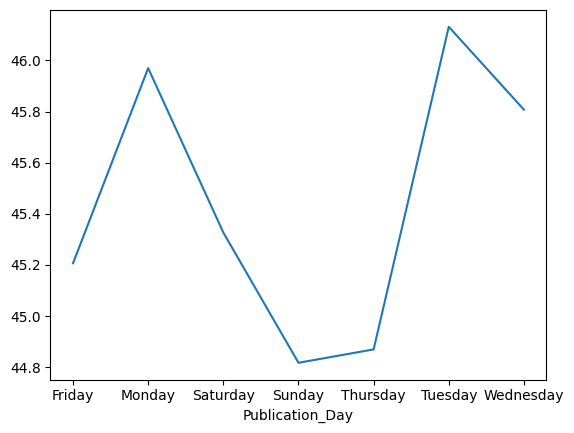

In [123]:
train_df.groupby('Publication_Day')['Listening_Time_minutes'].mean().plot()

## Direct Relationship


In [177]:
data = train_df.copy()

In [179]:
data['Guest_Popularity_percentage_binned'] = pd.cut(data['Guest_Popularity_percentage'], bins=10, labels=False, include_lowest=True)

<Axes: xlabel='Guest_Popularity_percentage_binned'>

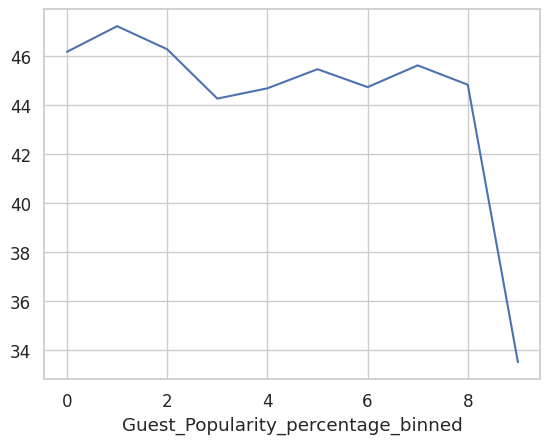

In [180]:
data.groupby('Guest_Popularity_percentage_binned')['Listening_Time_minutes'].mean().plot()

<Axes: xlabel='Publication_Day'>

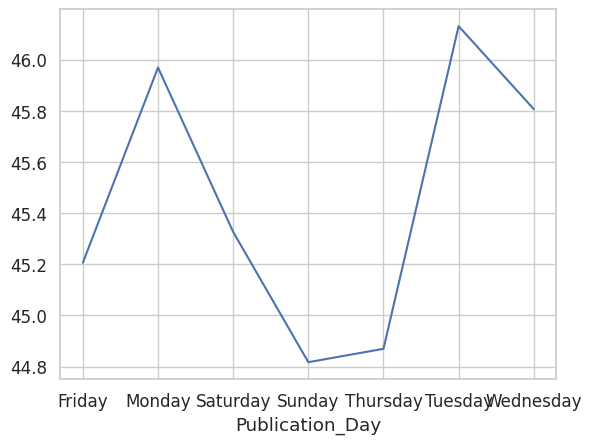

In [182]:
data.groupby('Publication_Day')['Listening_Time_minutes'].mean().plot()

## Direct versus Indirect - Relationship with Target

<Axes: xlabel='Podcast_Name'>

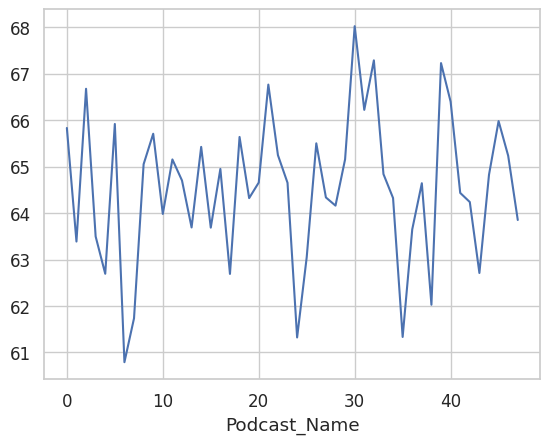

In [140]:
df.groupby('Podcast_Name')['Episode_Length_minutes'].mean().plot()

In [142]:
df.Episode_Length_minutes.mean()

np.float64(64.55529113963092)

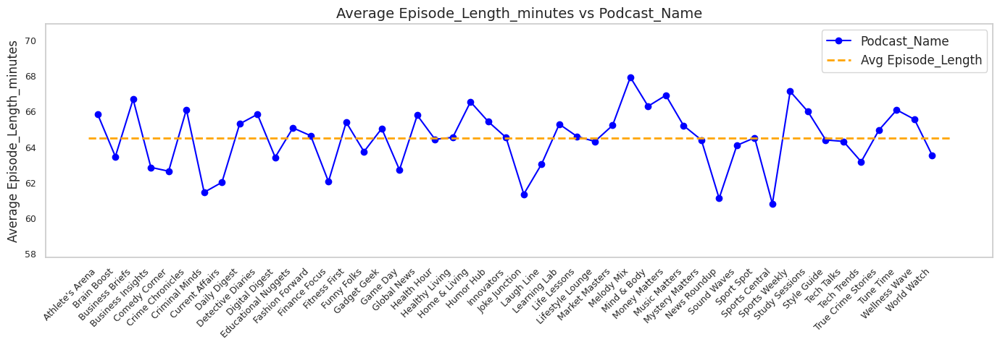

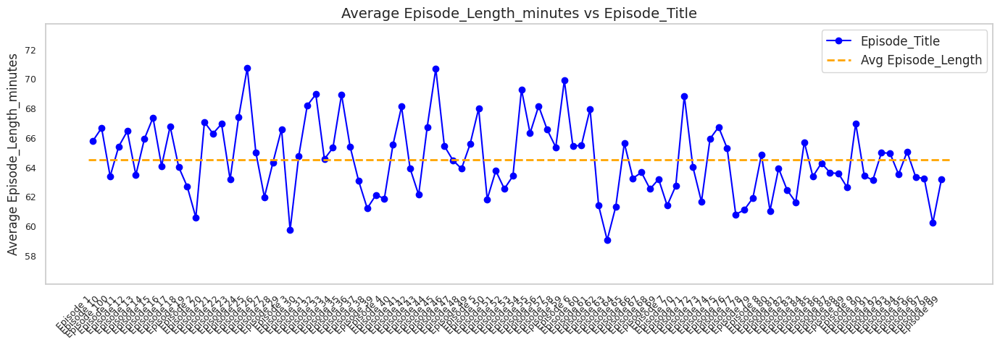

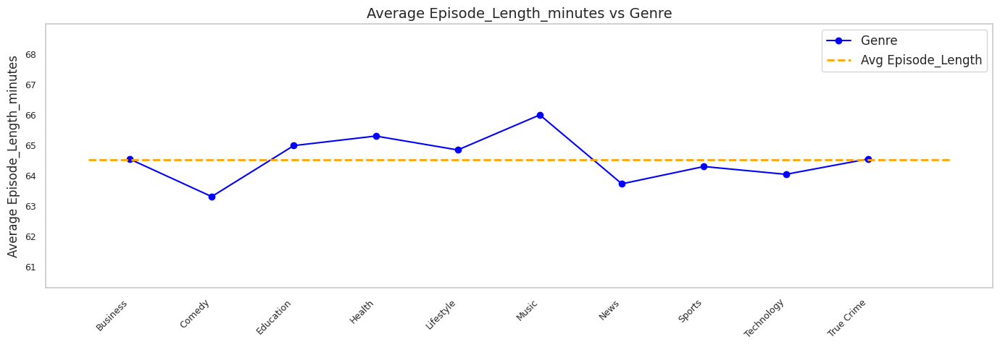

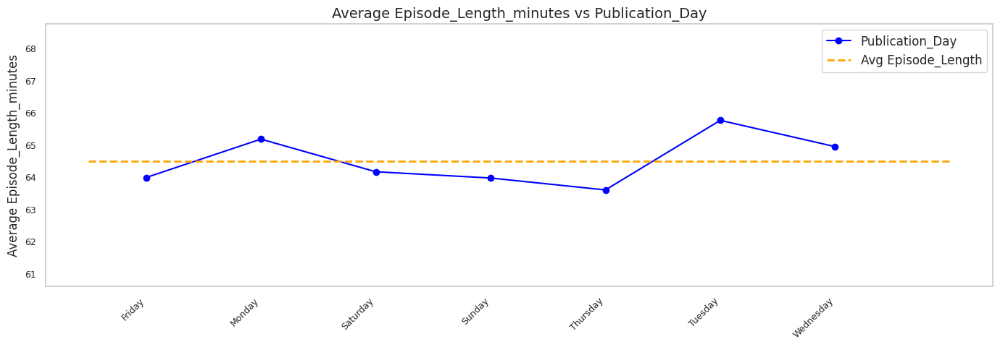

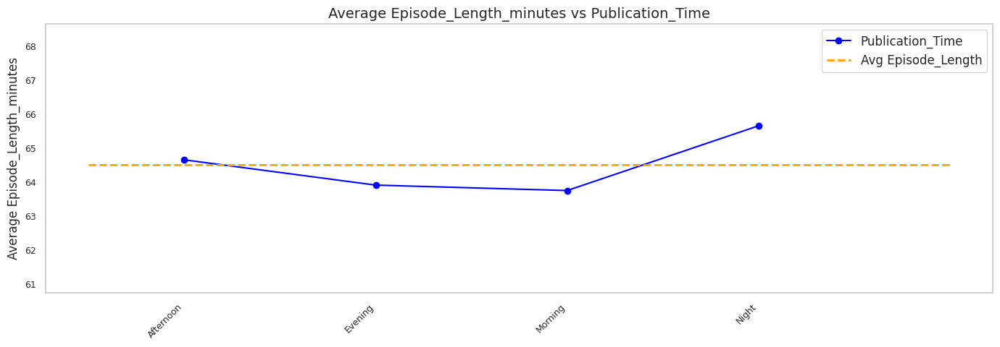

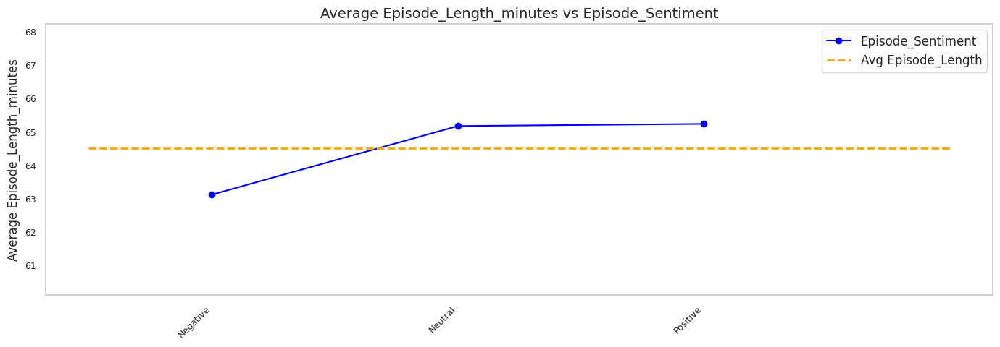

In [174]:
def plot_avg_episode_length_by_category(df, cat_col, target_col='Episode_Length_minutes'):
    group_avg = df.groupby(cat_col)[target_col].mean()
    overall_avg = df[target_col].mean()

    plt.figure(figsize=(14, 5))
    plt.plot(group_avg.index, group_avg.values, marker='o', color='blue', label=cat_col)

    # Horizontal line with padding
    plt.hlines(
        y=overall_avg,
        xmin=-0.5,
        xmax=len(group_avg),
        colors='orange',
        linestyles='--',
        linewidth=2,
        label='Avg Episode_Length'
    )

    plt.title(f'Average {target_col} vs {cat_col}', fontsize=14)
    plt.ylabel(f'Average {target_col}', fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=9)
    plt.yticks(fontsize=9)
    plt.ylim(group_avg.min() - 3, group_avg.max() + 3)
    plt.grid(False)
    plt.legend()
    plt.tight_layout()
    plt.show()


# Automatically plot for all categorical columns
categorical_cols = train_df.select_dtypes(include='object').columns

for col in categorical_cols:
    plot_avg_episode_length_by_category(train_df, col)


In [150]:
df.head()

,Podcast_Name,Episode_Title,Episode_Length_minutes,Genre,Host_Popularity_percentage,Publication_Day,Publication_Time,Guest_Popularity_percentage,Number_of_Ads,Episode_Sentiment,Listening_Time_minutes,Length_x_Ads
1,24,19,119.80,1,66.95,2,0,75.95,2.0,0,88.01241,239.60
2,40,8,73.90,2,69.97,5,1,8.97,0.0,0,44.92531,0.00
3,10,40,67.17,8,57.22,1,2,78.70,2.0,2,46.27824,134.34
4,31,85,110.51,3,80.07,1,0,58.68,3.0,1,75.61031,331.53
6,6,42,69.83,9,35.82,3,3,39.02,0.0,1,64.75024,0.00
